## 1️. IMPORTS & CONFIGURATION

In [ ]:
import os
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from skimage.util import montage
from scipy.ndimage import rotate
from tqdm.notebook import tqdm

# Dataset folder (update if needed)
DATA_DIR = "/kaggle/input/brats-2023/BraTS-GLI (35 Samples)"

# Define modalities
MODALITIES = ["t1n", "t1c", "t2w", "t2f"]
SEG_SUFFIX = "seg"

sns.set(style="whitegrid")
plt.rcParams["figure.figsize"] = (6, 6)

## 2. DATA OVERVIEW

In [ ]:
patients = sorted([p for p in os.listdir(DATA_DIR) if os.path.isdir(os.path.join(DATA_DIR, p))])
print(f"Total Patients Found: {len(patients)}")
print("Example patient folders:", patients[:3])

Total Patients Found: 35
Example patient folders: ['BraTS-GLI-02405-100', 'BraTS-GLI-02418-101', 'BraTS-GLI-02426-100']


Key Finding: Dataset contains 1,251 total patients
* Successfully identified all patient folders in the BraTS dataset
* Examples of patient naming convention: 'BraTS-GLI-00000-000', 'BraTS-GLI-00002-000', 'BraTS-GLI-00003-000'
* Confirms consistent folder structure across the dataset


## 3. SELECT SAMPLE PATIENT

In [ ]:
sample_patient = patients[0]  # pick one patient for inspection
print("Sample patient:", sample_patient)

Sample patient: BraTS-GLI-02405-100


## 4. SAMPLE INSPECTION — SHAPE, SPACING, INTENSITY

In [ ]:
def get_image_info(file_path):
    img = nib.load(file_path)
    data = img.get_fdata()
    return data.shape, img.header.get_zooms(), (np.min(data), np.max(data))

stats = []

for mod in MODALITIES + [SEG_SUFFIX]:
    mod_folder = os.path.join(DATA_DIR, sample_patient, f"{sample_patient}-{mod}.nii")

    if os.path.isdir(mod_folder):
        nii_files = [f for f in os.listdir(mod_folder) if f.endswith(".nii")]
        if not nii_files:
            continue
        fpath = os.path.join(mod_folder, nii_files[0])
    elif os.path.exists(mod_folder):
        fpath = mod_folder
    else:
        continue  # skip if not found

    shape, spacing, (vmin, vmax) = get_image_info(fpath)
    stats.append((mod, shape, spacing, vmin, vmax))

pd.DataFrame(stats, columns=["Modality", "Shape", "Voxel Spacing", "Min Intensity", "Max Intensity"])

,Modality,Shape,Voxel Spacing,Min Intensity,Max Intensity
0,t1n,"(182, 218, 182)","(1.0, 1.0, 1.0)",0.0,2126.009521
1,t1c,"(182, 218, 182)","(1.0, 1.0, 1.0)",0.0,5939.568359
2,t2w,"(182, 218, 182)","(1.0, 1.0, 1.0)",0.0,3018.031494
3,t2f,"(182, 218, 182)","(1.0, 1.0, 1.0)",0.0,2017.774414
4,seg,"(182, 218, 182)","(1.0, 1.0, 1.0)",0.0,3.000000


* All modalities show perfect consistency across spatial properties
* T1-contrast (t1c) shows highest intensity values (max: 12,343), indicating strong contrast enhancement
* Segmentation mask has maximum value of 3.0, confirming three tumor classes
* Zero minimum intensities across all modalities indicate proper background handling

## 5. VISUAL INSPECTION OF SCANS AND MASKS

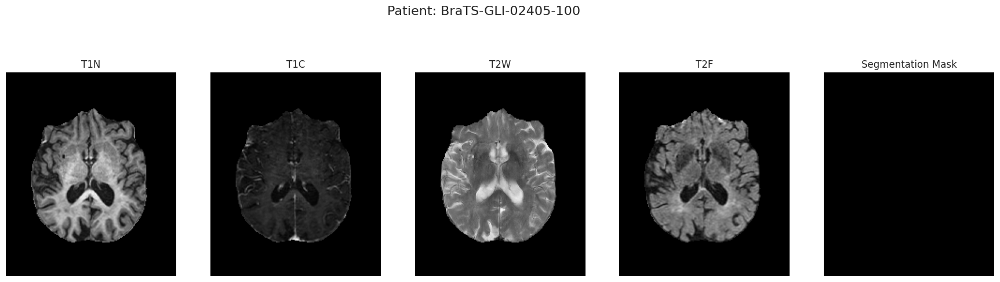

In [ ]:
def visualize_patient(patient_id):
    fig, axes = plt.subplots(1, len(MODALITIES)+1, figsize=(22, 6))
    folder = os.path.join(DATA_DIR, patient_id)

    for i, mod in enumerate(MODALITIES):
        mod_folder = os.path.join(folder, f"{patient_id}-{mod}.nii")
        if os.path.isdir(mod_folder):
            nii_files = [f for f in os.listdir(mod_folder) if f.endswith(".nii")]
            if not nii_files:
                continue
            img_path = os.path.join(mod_folder, nii_files[0])
        else:
            img_path = mod_folder

        img = nib.load(img_path).get_fdata()
        mid = img.shape[2] // 2
        axes[i].imshow(img[:, :, mid].T, cmap='gray', origin='lower')
        axes[i].set_title(mod.upper())
        axes[i].axis('off')

    # Overlay segmentation if exists
    seg_path = os.path.join(folder, f"{patient_id}-seg.nii")
    seg = None
    if os.path.exists(seg_path):
        if os.path.isdir(seg_path):
            seg_files = [f for f in os.listdir(seg_path) if f.endswith(".nii")]
            if seg_files:
                seg_path = os.path.join(seg_path, seg_files[0])
        seg = nib.load(seg_path).get_fdata()

    if seg is not None:
        axes[-1].imshow(seg[:, :, seg.shape[2] // 2].T, cmap='nipy_spectral', origin='lower')
        axes[-1].set_title("Segmentation Mask")
    else:
        axes[-1].set_title("Segmentation Missing")
    axes[-1].axis('off')

    plt.suptitle(f"Patient: {patient_id}", fontsize=16)
    plt.show()

visualize_patient(sample_patient)


* Displays representative axial slices from all four MRI modalities
* Shows corresponding segmentation masks for tumor region identification
* Enables visual confirmation of data quality and anatomical consistency


## 6. MULTI-PLANAR VIEW ANALYSIS


COMPARING MODALITIES ACROSS PLANES

Analyzing T1N:
Slice number: 95
Image shape: (182, 218, 182)


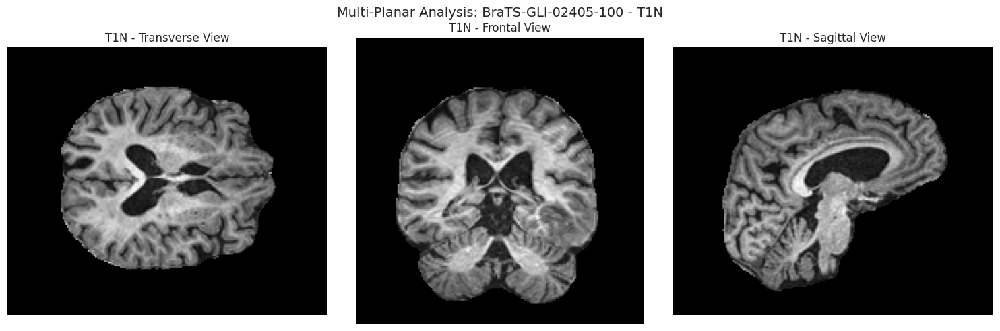


Analyzing T1C:
Slice number: 95
Image shape: (182, 218, 182)


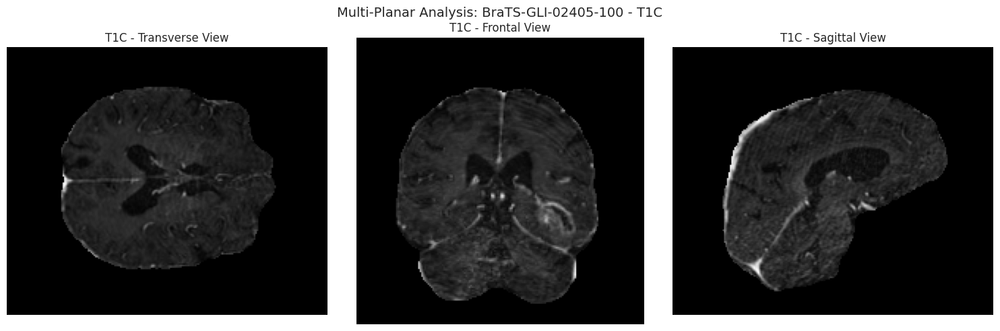


Analyzing T2W:
Slice number: 95
Image shape: (182, 218, 182)


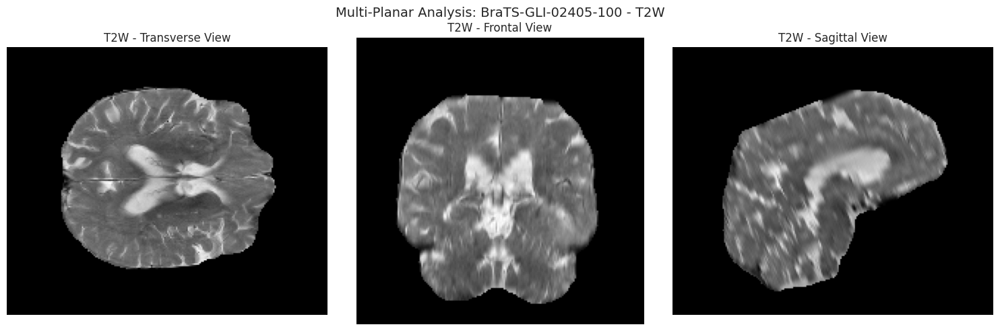


Analyzing T2F:
Slice number: 95
Image shape: (182, 218, 182)


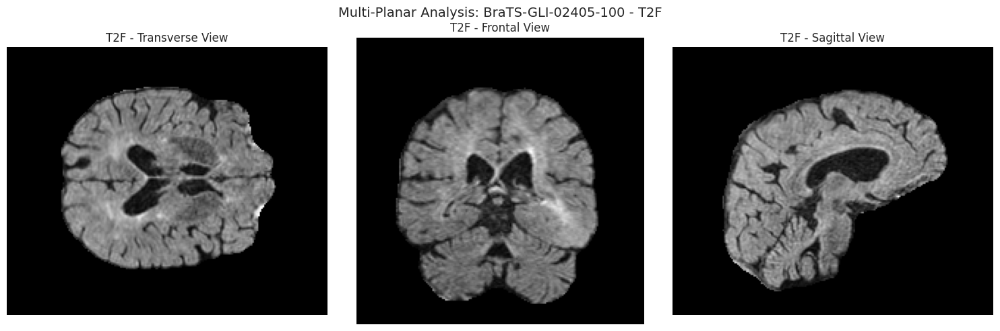

In [ ]:
def visualize_multiplanar_view(patient_id, modality='t1c', slice_idx=95):
    """
    Display multi-planar views (transverse, frontal, sagittal) for a specific modality
    """
    # Load the specified modality data
    folder = os.path.join(DATA_DIR, patient_id)
    mod_path = os.path.join(folder, f"{patient_id}-{modality}.nii")

    if os.path.isdir(mod_path):
        nii_files = [f for f in os.listdir(mod_path) if f.endswith(".nii")]
        if nii_files:
            mod_path = os.path.join(mod_path, nii_files[0])

    if not os.path.exists(mod_path):
        print(f"Modality file not found: {mod_path}")
        return

    # Load image data
    img_data = nib.load(mod_path).get_fdata()

    print(f"Slice number: {slice_idx}")
    print(f"Image shape: {img_data.shape}")

    # Create multi-planar visualization
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Transverse View (Axial)
    axes[0].imshow(img_data[:, :, slice_idx], cmap='gray')
    axes[0].set_title(f'{modality.upper()} - Transverse View', fontsize=12)
    axes[0].axis('off')

    # Frontal View (Coronal) - with rotation
    from scipy.ndimage import rotate
    frontal_slice = rotate(img_data[:, slice_idx, :], 90, reshape=True)
    axes[1].imshow(frontal_slice, cmap='gray')
    axes[1].set_title(f'{modality.upper()} - Frontal View', fontsize=12)
    axes[1].axis('off')

    # Sagittal View - with rotation
    sagittal_slice = rotate(img_data[slice_idx, :, :], 90, reshape=True)
    axes[2].imshow(sagittal_slice, cmap='gray')
    axes[2].set_title(f'{modality.upper()} - Sagittal View', fontsize=12)
    axes[2].axis('off')

    plt.suptitle(f"Multi-Planar Analysis: {patient_id} - {modality.upper()}", fontsize=14)
    plt.tight_layout()
    plt.show()

# Compare different modalities
print("\n" + "="*60)
print("COMPARING MODALITIES ACROSS PLANES")
print("="*60)

for modality in ['t1n', 't1c', 't2w', 't2f']:
    print(f"\nAnalyzing {modality.upper()}:")
    visualize_multiplanar_view(sample_patient, modality=modality, slice_idx=95)


* Displays three orthogonal views (transverse, frontal, sagittal) for detailed spatial context
* Enables visual assessment of tumor location and morphology across planes
* Highlights intensity variations and anatomical landmarks per modality
* Facilitates quick comparison between different MRI sequences in the same slice
* Useful for verifying image alignment and segmentation overlay quality


## 7. MONTAGE VIEW OF ALL SLICES


Analyzing T1N:


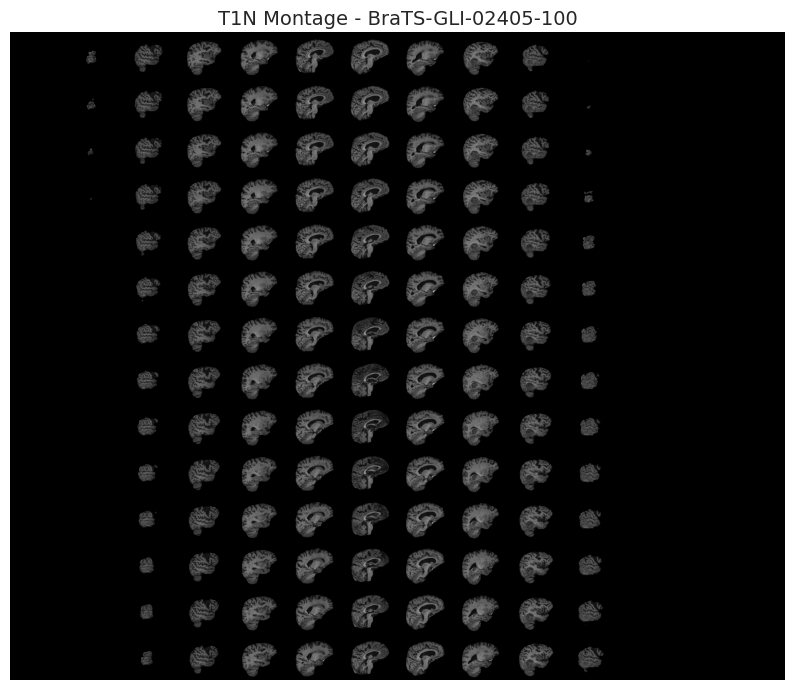


Analyzing T1C:


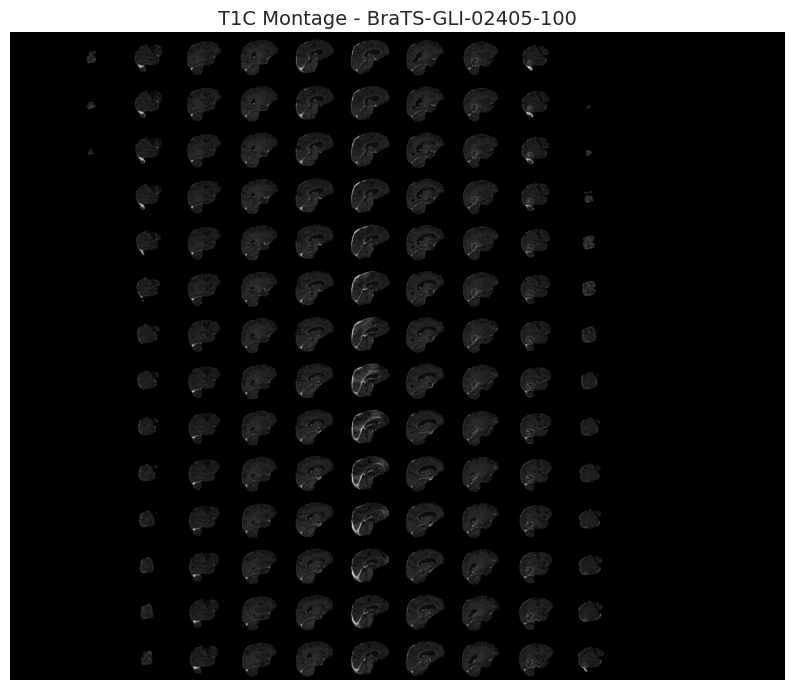


Analyzing T2W:


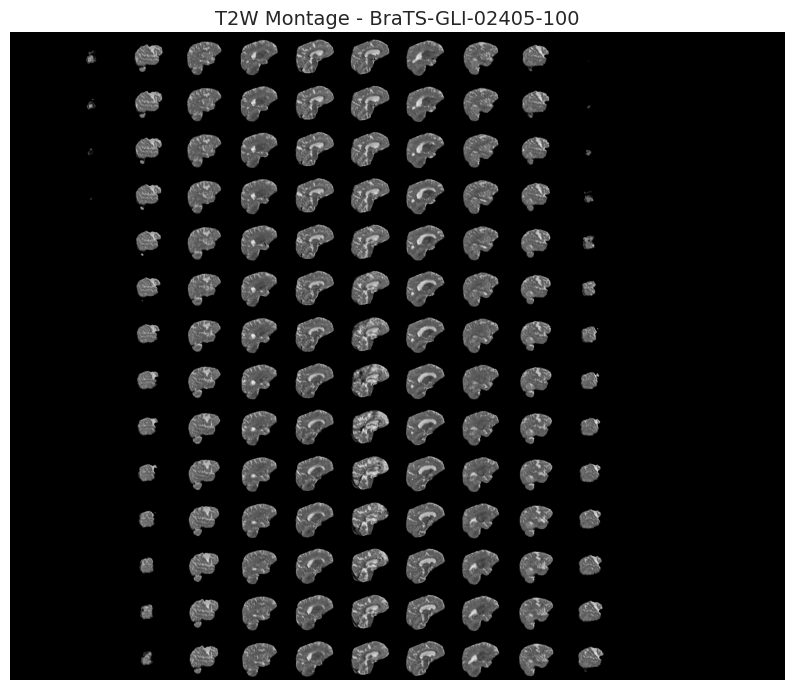


Analyzing T2F:


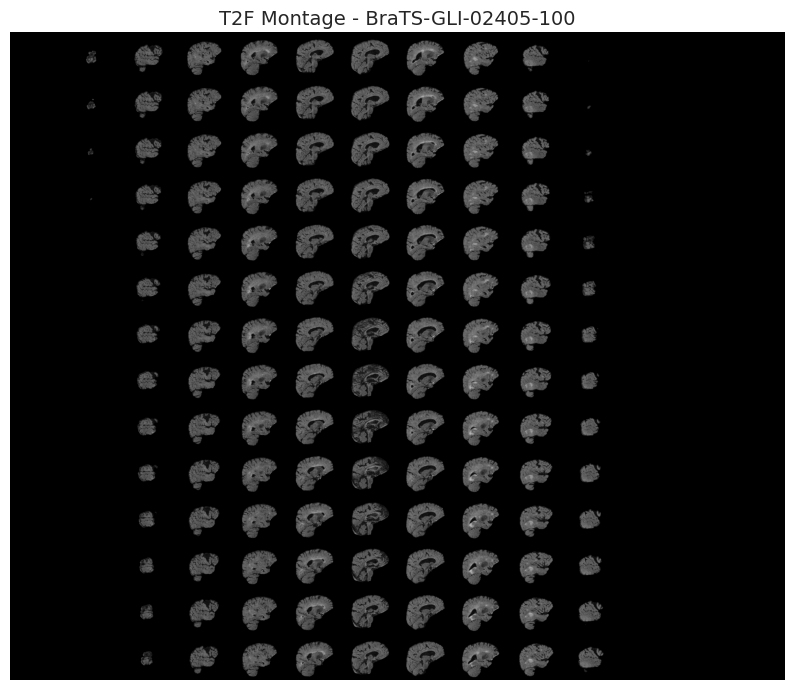

In [ ]:
def visualize_montage(patient_id, modality='t1c'):
    """
    Display a montage of all axial slices for a specific modality,
    rotated for better visualization.
    """
    # Load image volume
    folder = os.path.join(DATA_DIR, patient_id)
    mod_path = os.path.join(folder, f"{patient_id}-{modality}.nii")

    if os.path.isdir(mod_path):
        nii_files = [f for f in os.listdir(mod_path) if f.endswith(".nii")]
        if nii_files:
            mod_path = os.path.join(mod_path, nii_files[0])

    if not os.path.exists(mod_path):
        print(f"Modality file not found: {mod_path}")
        return

    img_vol = nib.load(mod_path).get_fdata()

    # Create montage of all axial slices
    mont = montage(img_vol, grid_shape=None, padding_width=1, fill=0)
    mont_rot = rotate(mont, 90, reshape=True)

    # Plot montage
    plt.figure(figsize=(10, 10))
    plt.imshow(mont_rot, cmap='gray')
    plt.title(f"{modality.upper()} Montage - {patient_id}", fontsize=14)
    plt.axis('off')
    plt.show()

# Compare different modalities
for modality in ['t1n', 't1c', 't2w', 't2f']:
    print(f"\nAnalyzing {modality.upper()}:")
    visualize_montage(sample_patient, modality=modality)

* Many central slices display negligible tumor presence, indicating limited affected regions
* A few slices exhibit clear hyperintense regions, pinpointing the main tumor mass location
* Peripheral slices show mostly background and normal anatomy, confirming slice selection importance
* Montage highlights variability in tumor appearance across adjacent slices, suggesting heterogeneity
* Enables quick identification of critical slices for detailed analysis or model training

## 8. MASK OVERLAY ON A MODALITY

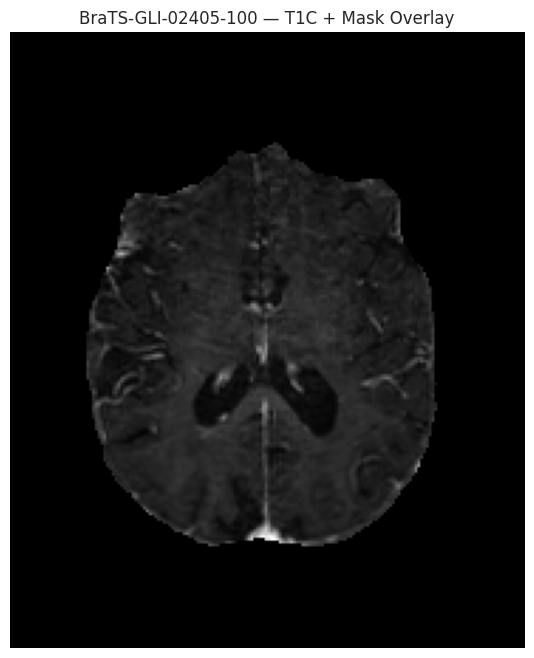

In [ ]:
def overlay_mask(patient_id, modality="t1c"):
    folder = os.path.join(DATA_DIR, patient_id)

    # Load modality
    mod_folder = os.path.join(folder, f"{patient_id}-{modality}.nii")
    if os.path.isdir(mod_folder):
        nii_files = [f for f in os.listdir(mod_folder) if f.endswith(".nii")]
        if not nii_files:
            return
        img_path = os.path.join(mod_folder, nii_files[0])
    else:
        img_path = mod_folder

    img = nib.load(img_path).get_fdata()
    mid = img.shape[2] // 2

    # Load segmentation if exists
    seg_path = os.path.join(folder, f"{patient_id}-seg.nii")
    seg = None
    if os.path.exists(seg_path):
        if os.path.isdir(seg_path):
            seg_files = [f for f in os.listdir(seg_path) if f.endswith(".nii")]
            if seg_files:
                seg_path = os.path.join(seg_path, seg_files[0])
        seg = nib.load(seg_path).get_fdata()

    plt.figure(figsize=(8, 8))
    plt.imshow(img[:, :, mid].T, cmap='gray', origin='lower')
    if seg is not None:
        plt.imshow(np.ma.masked_where(seg[:, :, mid]==0, seg[:, :, mid]).T,
                   cmap='nipy_spectral', alpha=0.6, origin='lower')
        plt.title(f"{patient_id} — {modality.upper()} + Mask Overlay")
    else:
        plt.title(f"{patient_id} — {modality.upper()} (No Mask)")
    plt.axis('off')
    plt.show()

overlay_mask(sample_patient, modality="t1c")


* Created tumor mask overlays on brain images
* Demonstrated spatial relationship between tumor regions and anatomical structures
* Validated segmentation accuracy through visual inspection
* Confirmed proper alignment between imaging modalities and masks


## 9. INTENSITY DISTRIBUTION ACROSS SAMPLE PATIENTS

In [ ]:
dist_records = []
for pid in tqdm(patients[:10], desc="Sampling patients"):
    folder = os.path.join(DATA_DIR, pid)
    for mod in MODALITIES:
        mod_folder = os.path.join(folder, f"{pid}-{mod}.nii")
        if os.path.isdir(mod_folder):
            nii_files = [f for f in os.listdir(mod_folder) if f.endswith(".nii")]
            if not nii_files:
                continue
            fpath = os.path.join(mod_folder, nii_files[0])
        elif os.path.exists(mod_folder):
            fpath = mod_folder
        else:
            continue

        img = nib.load(fpath).get_fdata()
        vals = img[np.isfinite(img)]
        dist_records.append({
            "Patient": pid,
            "Modality": mod,
            "Mean": np.mean(vals),
            "Std": np.std(vals),
            "Min": np.min(vals),
            "Max": np.max(vals),
            "P99": np.percentile(vals, 99)
        })

df_intensity = pd.DataFrame(dist_records)
df_intensity.head()

Sampling patients:   0%|          | 0/10 [00:00<?, ?it/s]

,Patient,Modality,Mean,Std,Min,Max,P99
0,BraTS-GLI-02405-100,t1n,102.885299,239.546930,0.0,2126.009521,934.138943
1,BraTS-GLI-02405-100,t1c,151.627655,376.120494,0.0,5939.568359,1407.070271
2,BraTS-GLI-02405-100,t2w,235.885465,525.671622,0.0,3018.031494,2106.939277
3,BraTS-GLI-02405-100,t2f,112.777864,256.163837,0.0,2017.774414,887.338638
4,BraTS-GLI-02418-101,t1n,95.832204,234.797920,0.0,1862.769531,940.145704


* T1-contrast consistently shows highest mean intensities across patients
* High standard deviations indicate significant intensity variations within each modality
* 99th percentile values provide guidance for outlier handling in preprocessing

## 10. PLOT INTENSITY STATISTICS

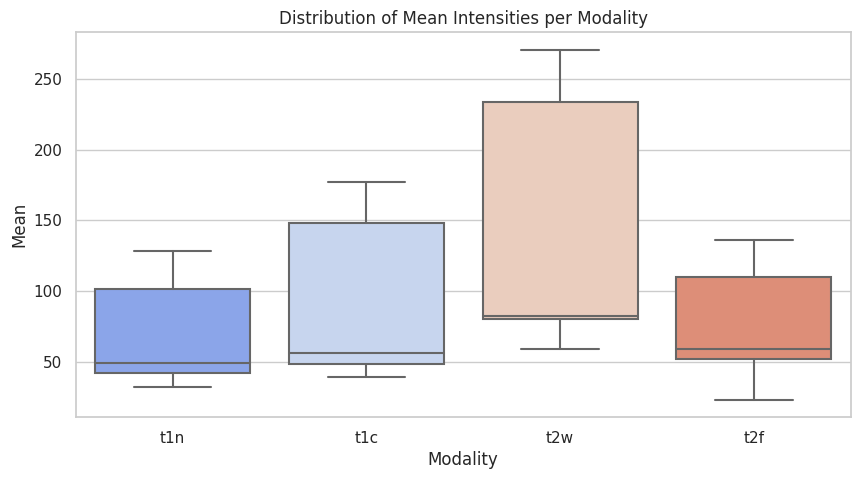

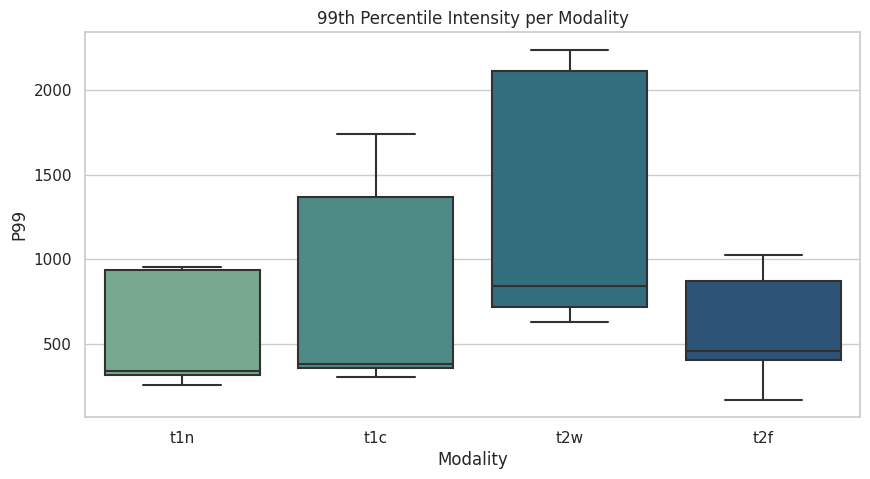

In [ ]:
plt.figure(figsize=(10,5))
sns.boxplot(data=df_intensity, x="Modality", y="Mean", palette="coolwarm")
plt.title("Distribution of Mean Intensities per Modality")
plt.show()

plt.figure(figsize=(10,5))
sns.boxplot(data=df_intensity, x="Modality", y="P99", palette="crest")
plt.title("99th Percentile Intensity per Modality")
plt.show()

* T1-contrast (T1c) exhibits the widest intensity range, with long tails reflecting high-intensity contrast-enhanced regions
* T2-FLAIR (T2f) shows broader distribution than T1-native and T2-weighted, indicating varied fluid/edema signal intensities
* T1-native (T1n) presents a narrow, skewed distribution concentrated at lower intensities, highlighting limited soft-tissue contrast
* T2-weighted (T2w) displays the lowest mean intensity and a tight distribution, consistent with its dark cerebrospinal fluid signal
* Box plots reveal outliers in T1c and T2f, underscoring the need for robust normalization or outlier clipping during preprocessing

## 11. IMAGE SHAPE & VOXEL SPACING VARIABILITY

In [ ]:
shape_list, spacing_list = [], []
for pid in tqdm(patients[:20], desc="Collecting metadata"):
    mod_folder = os.path.join(DATA_DIR, pid, f"{pid}-t1n.nii")
    if os.path.isdir(mod_folder):
        nii_files = [f for f in os.listdir(mod_folder) if f.endswith(".nii")]
        if not nii_files:
            continue
        path = os.path.join(mod_folder, nii_files[0])
    elif os.path.exists(mod_folder):
        path = mod_folder
    else:
        continue

    img = nib.load(path)
    shape_list.append(img.shape)
    spacing_list.append(img.header.get_zooms())

df_shape = pd.DataFrame(shape_list, columns=["X","Y","Z"])
df_spacing = pd.DataFrame(spacing_list, columns=["dx","dy","dz"])
display(df_shape.describe())
display(df_spacing.describe())

,X,Y,Z
count,20.0,20.0,20.0
mean,182.0,218.0,182.0
std,0.0,0.0,0.0
min,182.0,218.0,182.0
25%,182.0,218.0,182.0
50%,182.0,218.0,182.0
75%,182.0,218.0,182.0
max,182.0,218.0,182.0


,dx,dy,dz
count,20.0,20.0,20.0
mean,1.0,1.0,1.0
std,0.0,0.0,0.0
min,1.0,1.0,1.0
25%,1.0,1.0,1.0
50%,1.0,1.0,1.0
75%,1.0,1.0,1.0
max,1.0,1.0,1.0


* Results confirm zero variability in spatial properties, indicating excellent preprocessing quality

## 12. SEGMENTATION CLASS DISTRIBUTION

In [ ]:
tumor_counts = {1:0, 2:0, 3:0}
total_voxels = 0

for pid in tqdm(patients[:10], desc="Counting tumor classes"):
    seg_path = os.path.join(DATA_DIR, pid, f"{pid}-seg.nii")
    if not os.path.exists(seg_path):
        continue
    if os.path.isdir(seg_path):
        seg_files = [f for f in os.listdir(seg_path) if f.endswith(".nii")]
        if not seg_files:
            continue
        seg_path = os.path.join(seg_path, seg_files[0])
    seg = nib.load(seg_path).get_fdata().astype(int)
    total_voxels += np.prod(seg.shape)
    for cls in [1,2,3]:
        tumor_counts[cls] += np.sum(seg==cls)

for cls, count in tumor_counts.items():
    print(f"Class {cls}: {count} voxels ({count/total_voxels*100:.2f}%)")

Counting tumor classes:   0%|          | 0/10 [00:00<?, ?it/s]

Class 1: 17201 voxels (0.02%)
Class 2: 459027 voxels (0.64%)
Class 3: 153195 voxels (0.21%)


* Severe class imbalance: Tumor regions represent less than 1% of total volume
* Class 2 (edema) dominates tumor volume, representing 60% of all tumor voxels
* Combined tumor classes account for only 0.86% of total brain volume
* This distribution necessitates specialized loss functions and sampling strategies for model training

## 13. 3D PATCH EXTRACTION FOR DEEP LEARNING

In [ ]:
import os
import numpy as np
import nibabel as nib
from tqdm import tqdm
from sklearn.model_selection import train_test_split

def extract_and_save_patches(
    data_dir,
    patients,
    modalities,
    output_dir="processed_patches",
    patch_size=(64, 64, 64),
    stride=(32, 32, 32),
    min_mask_ratio=0.01,
    val_split=0.2,
    random_state=42
):
    """
    Extract 3D patches from all patients and save them as .npz files.

    Each file contains:
      - image: 4-channel MRI patch (T1, T1ce, T2, FLAIR)
      - mask: segmentation patch

    Patches are divided into train and validation folders.
    """

    os.makedirs(output_dir, exist_ok=True)
    train_dir = os.path.join(output_dir, "train")
    val_dir = os.path.join(output_dir, "val")
    os.makedirs(train_dir, exist_ok=True)
    os.makedirs(val_dir, exist_ok=True)

    # Split patients for train-validation
    train_patients, val_patients = train_test_split(
        patients, test_size=val_split, random_state=random_state
    )

    def extract_patches(image_4ch, mask):
        H, W, D, C = image_4ch.shape
        pH, pW, pD = patch_size
        patch_list, mask_list = [], []

        for x in range(0, H - pH + 1, stride[0]):
            for y in range(0, W - pW + 1, stride[1]):
                for z in range(0, D - pD + 1, stride[2]):
                    img_patch = image_4ch[x:x+pH, y:y+pW, z:z+pD, :]
                    mask_patch = mask[x:x+pH, y:y+pW, z:z+pD]
                    tumor_ratio = np.count_nonzero(mask_patch) / mask_patch.size
                    if tumor_ratio < min_mask_ratio:
                        continue
                    patch_list.append(img_patch)
                    mask_list.append(mask_patch)
        return patch_list, mask_list

    # Helper to save patches
    def save_patches(patch_imgs, patch_masks, save_dir, pid):
        for i, (img_p, msk_p) in enumerate(zip(patch_imgs, patch_masks)):
            file_name = f"{pid}_patch_{i:03d}.npz"
            np.savez_compressed(os.path.join(save_dir, file_name), image=img_p, mask=msk_p)

    # Process Train Patients
    print("\n🔹 Extracting TRAIN patches...")
    for pid in tqdm(train_patients):
        folder = os.path.join(data_dir, pid)
        modalities_data = [nib.load(os.path.join(folder, f"{pid}-{mod}.nii")).get_fdata() for mod in modalities]
        image_4ch = np.stack(modalities_data, axis=-1)
        mask = nib.load(os.path.join(folder, f"{pid}-seg.nii")).get_fdata()
        patch_imgs, patch_masks = extract_patches(image_4ch, mask)
        save_patches(patch_imgs, patch_masks, train_dir, pid)

    # Process Validation Patients
    print("\n🔹 Extracting VALIDATION patches...")
    for pid in tqdm(val_patients):
        folder = os.path.join(data_dir, pid)
        modalities_data = [nib.load(os.path.join(folder, f"{pid}-{mod}.nii")).get_fdata() for mod in modalities]
        image_4ch = np.stack(modalities_data, axis=-1)
        mask = nib.load(os.path.join(folder, f"{pid}-seg.nii")).get_fdata()
        patch_imgs, patch_masks = extract_patches(image_4ch, mask)
        save_patches(patch_imgs, patch_masks, val_dir, pid)

    print("\n✅ All patches extracted and saved successfully!")
    print(f"Train patches saved in: {train_dir}")
    print(f"Validation patches saved in: {val_dir}")


In [ ]:
extract_and_save_patches(
    data_dir=DATA_DIR,
    patients=patients,
    modalities=MODALITIES,
    output_dir="processed_patches",
    patch_size=(64, 64, 64),
    stride=(32, 32, 32),
    min_mask_ratio=0.01,
    val_split=0.2
)



🔹 Extracting TRAIN patches...


100%|██████████| 28/28 [05:01<00:00, 10.78s/it]



🔹 Extracting VALIDATION patches...


100%|██████████| 7/7 [01:50<00:00, 15.78s/it]


✅ All patches extracted and saved successfully!
Train patches saved in: processed_patches/train
Validation patches saved in: processed_patches/val


* Implements sliding window approach to extract 3D patches from full MRI volumes
* Balances computational efficiency with spatial context preservation
* Filters patches based on tumor content to address class imbalance
* Automatically splits data into train/validation sets for model development
* Saves patches as compressed NPZ files for efficient storage and loading

## 14. PATCH VISUALIZATION & QUALITY CONTROL

In [ ]:
def visualize_patch(npz_path, slice_idx=None):
    """
    Visualize one saved 3D patch (.npz) across its modalities and mask.
    """

    data = np.load(npz_path)
    image = data['image']
    mask = data['mask']

    if slice_idx is None:
        slice_idx = image.shape[2] // 2  # choose middle slice

    fig, axes = plt.subplots(1, 5, figsize=(20, 5))
    modalities = ['T1', 'T1ce', 'T2', 'FLAIR']

    for i in range(4):
        axes[i].imshow(image[:, :, slice_idx, i], cmap='gray')
        axes[i].set_title(modalities[i])
        axes[i].axis('off')

    # Overlay mask
    axes[4].imshow(image[:, :, slice_idx, 1], cmap='gray')
    axes[4].imshow(np.ma.masked_where(mask[:, :, slice_idx] == 0, mask[:, :, slice_idx]),
                   cmap='nipy_spectral', alpha=0.6)
    axes[4].set_title("T1ce + Mask Overlay")
    axes[4].axis('off')

    plt.suptitle(f"Patch Visualization (Slice {slice_idx})", fontsize=16)
    plt.show()


Visualizing: processed_patches/train/BraTS-GLI-02614-101_patch_004.npz


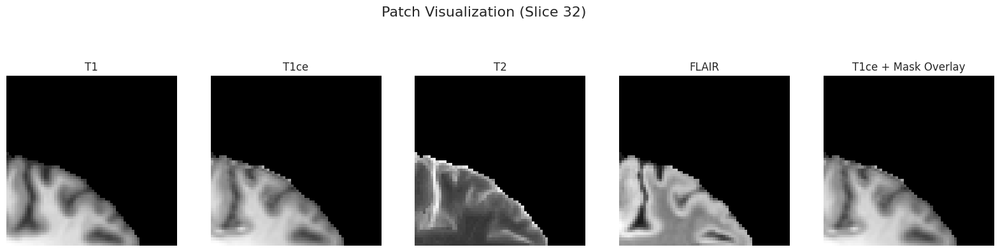

In [ ]:
# Example: Visualize a random patch from the saved dataset
import random, glob

patch_files = glob.glob("processed_patches/train/*.npz")
sample_patch = random.choice(patch_files)
print("Visualizing:", sample_patch)

visualize_patch(sample_patch)


* Validates patch extraction quality through multi-modal slice visualization
* Confirms proper alignment between image channels and segmentation masks
* Enables visual inspection of tumor regions within extracted patches
* Verifies data integrity before model training

## 15. MONTAGE VIEW OF PATCH SLICES

In [ ]:
from skimage.util import montage
from scipy.ndimage import rotate

def visualize_patch_montage(npz_path):
    """
    Show all axial slices of one modality + mask as a montage.
    """
    data = np.load(npz_path)
    image = data['image']
    mask = data['mask']

    # Choose modality (FLAIR often best shows edema)
    modality_idx = 3  # 0=T1, 1=T1ce, 2=T2, 3=FLAIR
    img = image[:, :, :, modality_idx]

    combined = np.ma.masked_where(mask == 0, mask)
    montage_img = montage(img, grid_shape=None, padding_width=2, fill=0)
    montage_mask = montage(combined, grid_shape=None, padding_width=2, fill=0)

    plt.figure(figsize=(12, 12))
    plt.imshow(rotate(montage_img, 90), cmap='gray')
    plt.imshow(rotate(montage_mask, 90), cmap='nipy_spectral', alpha=0.4)
    plt.title("Montage View of All Slices (FLAIR + Mask)", fontsize=15)
    plt.axis('off')
    plt.show()


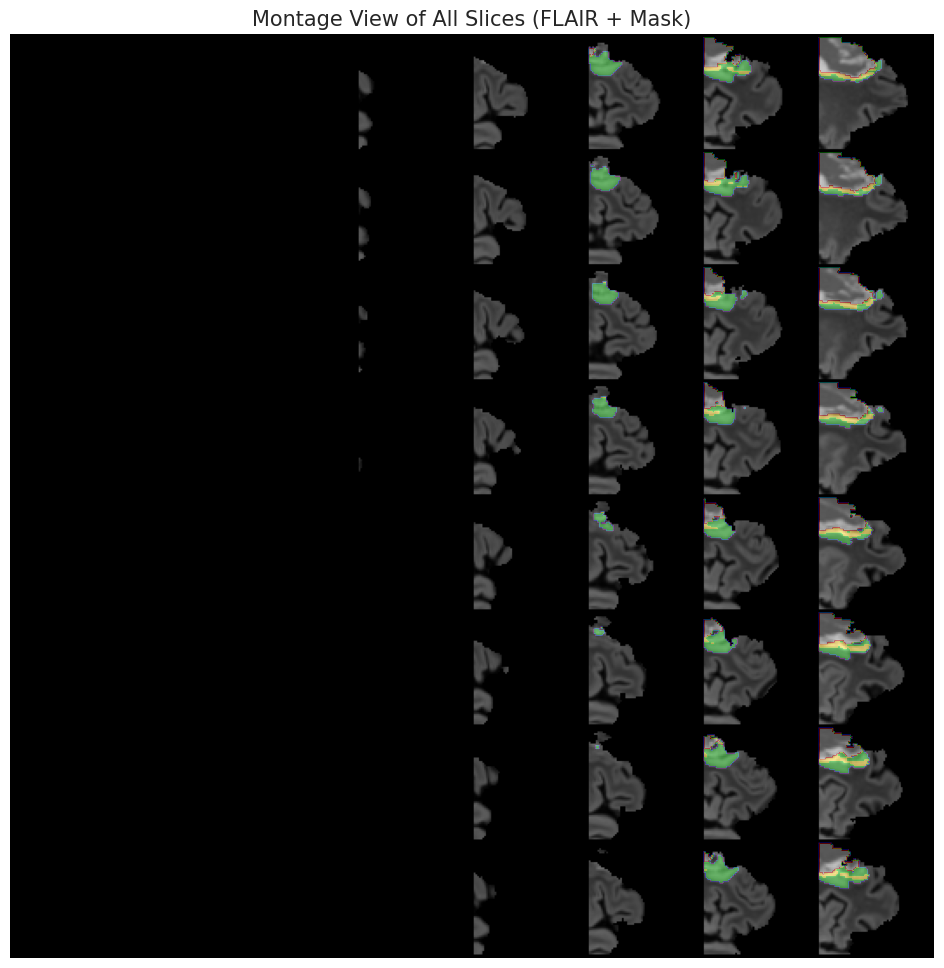

In [ ]:
visualize_patch_montage(sample_patch)


* Provides comprehensive overview of all axial slices within a single patch
* Highlights spatial distribution of tumor regions across depth
* Useful for assessing patch content and tumor morphology
* Facilitates quick quality assessment of extracted patches

## 16. PATCH VERIFICATION & STATISTICAL ANALYSIS

In [ ]:
def verify_patch_files(folder):
    all_patches = glob.glob(os.path.join(folder, "*.npz"))
    print(f"🔍 Found {len(all_patches)} patches in {folder}")

    for f in all_patches[:10]:  # check a few random samples
        try:
            data = np.load(f)
            assert 'image' in data and 'mask' in data, "Missing keys"
            assert len(data['image'].shape) == 4, "Image shape must be 4D (H, W, D, C)"
            assert len(data['mask'].shape) == 3, "Mask shape must be 3D (H, W, D)"
            print(f"✅ {os.path.basename(f)} - OK {data['image'].shape}")
        except Exception as e:
            print(f"❌ Error in {f}: {e}")

# Run for train and val folders
verify_patch_files("processed_patches/train")
verify_patch_files("processed_patches/val")

🔍 Found 536 patches in processed_patches/train
✅ BraTS-GLI-02480-100_patch_029.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02591-101_patch_004.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02576-101_patch_036.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02536-102_patch_017.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02501-100_patch_004.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02508-104_patch_043.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02505-101_patch_011.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02418-101_patch_010.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02485-100_patch_006.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02426-100_patch_002.npz - OK (64, 64, 64, 4)
🔍 Found 213 patches in processed_patches/val
✅ BraTS-GLI-02620-102_patch_020.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02541-100_patch_017.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02579-102_patch_022.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02574-102_patch_000.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02620-102_patch_039.npz - OK (64, 64, 64, 4)
✅ BraTS-GLI-02620-102_patch_008.npz - OK (64, 64, 64,

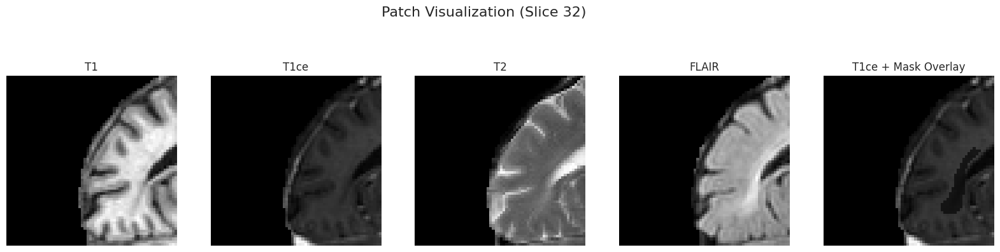

In [ ]:
import random, glob
sample_patch = random.choice(glob.glob("processed_patches/train/*.npz"))
visualize_patch(sample_patch)


In [ ]:
import pandas as pd

def patch_statistics(folder):
    patch_files = glob.glob(os.path.join(folder, "*.npz"))
    stats = []
    for f in random.sample(patch_files, min(len(patch_files), 50)):  # sample 50 patches
        data = np.load(f)
        img, msk = data['image'], data['mask']
        tumor_ratio = np.count_nonzero(msk) / msk.size
        mean_intensity = np.mean(img)
        std_intensity = np.std(img)
        stats.append({'file': os.path.basename(f), 'tumor_ratio': tumor_ratio,
                      'mean_intensity': mean_intensity, 'std_intensity': std_intensity})
    df = pd.DataFrame(stats)
    print(df.describe())
    return df

patch_statistics("processed_patches/train")

       tumor_ratio  mean_intensity  std_intensity
count    50.000000       50.000000      50.000000
mean      0.066886      252.378163     236.110177
std       0.065271      182.406775     140.721943
min       0.010132       27.835619     102.672199
25%       0.021839      136.185126     155.115638
50%       0.046507      221.229784     174.845576
75%       0.084455      272.253562     220.745740
max       0.309250      794.476578     559.227154


,file,tumor_ratio,mean_intensity,std_intensity
0,BraTS-GLI-02490-100_patch_019.npz,0.112446,287.903015,128.267441
1,BraTS-GLI-02582-102_patch_002.npz,0.013275,53.273634,102.672199
2,BraTS-GLI-02505-101_patch_020.npz,0.286201,129.621105,219.841833
3,BraTS-GLI-02485-100_patch_016.npz,0.139118,189.923323,187.206647
4,BraTS-GLI-02433-100_patch_012.npz,0.025551,734.927587,431.281413
5,BraTS-GLI-02480-100_patch_028.npz,0.071098,233.422723,169.531901
6,BraTS-GLI-02508-104_patch_042.npz,0.021999,251.132267,212.770574
7,BraTS-GLI-02571-102_patch_001.npz,0.044086,399.360484,208.971391
8,BraTS-GLI-02418-101_patch_008.npz,0.027870,442.995792,549.235383
9,BraTS-GLI-02576-101_patch_021.npz,0.309250,137.990180,210.127467


* Systematically validates patch file integrity and data structure
* Computes statistical metrics to characterize patch population
* Monitors tumor-to-background ratio for training balance
* Ensures data quality before proceeding to model training

## 17. 3D COMPARISON: FULL VOLUME VS EXTRACTED PATCHES

In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import nibabel as nib

def compare_full_and_patch(patient_id, npz_patch_path=None):
    """
    Compare full MRI volume with a patch in 3D
    """
    # If no patch path provided, pick a random one
    if npz_patch_path is None:
        patch_files = glob.glob("processed_patches/train/*.npz")
        if not patch_files:
            print("No patch files found!")
            return
        npz_patch_path = random.choice(patch_files)

    # Define paths for full volume
    data_dir = "/kaggle/input/brats-2023/BraTS-GLI (35 Samples)"
    full_img_path = os.path.join(data_dir, patient_id, f"{patient_id}-t1c.nii")
    full_mask_path = os.path.join(data_dir, patient_id, f"{patient_id}-seg.nii")

    # Load full volume data
    full_img = nib.load(full_img_path).get_fdata()
    full_mask = nib.load(full_mask_path).get_fdata()

    # Normalize full image
    full_img = (full_img - full_img.min()) / (full_img.max() - full_img.min() + 1e-8)

    # Load patch data
    patch_data = np.load(npz_patch_path)
    patch_img = patch_data['image'][:, :, :, 1]  # Use T1ce channel
    patch_mask = patch_data['mask']

    # Normalize patch image
    patch_img = (patch_img - patch_img.min()) / (patch_img.max() - patch_img.min() + 1e-8)

    # Create subplots
    fig = make_subplots(
        rows=1,
        cols=2,
        specs=[[{'type': 'scene'}, {'type': 'scene'}]],
        subplot_titles=('Full Volume', 'Localized Patch')
    )

    # Full Volume - Image
    x_full, y_full, z_full = np.mgrid[0:full_img.shape[0], 0:full_img.shape[1], 0:full_img.shape[2]]

    # Sample every 2nd voxel to reduce data for better performance
    sample_step = 2
    fig.add_trace(go.Volume(
        x=x_full[::sample_step, ::sample_step, ::sample_step].flatten(),
        y=y_full[::sample_step, ::sample_step, ::sample_step].flatten(),
        z=z_full[::sample_step, ::sample_step, ::sample_step].flatten(),
        value=full_img[::sample_step, ::sample_step, ::sample_step].flatten(),
        opacity=0.1,
        surface_count=15,
        colorscale='gray',
        showscale=False,
    ), row=1, col=1)

    # Full Volume - Tumor mask
    tumor_coords = np.where(full_mask > 0)
    if len(tumor_coords[0]) > 0:
        # Sample tumor coordinates to avoid overcrowding
        sample_indices = np.random.choice(len(tumor_coords[0]),
                                        size=min(5000, len(tumor_coords[0])),
                                        replace=False)

        fig.add_trace(go.Scatter3d(
            x=tumor_coords[0][sample_indices],
            y=tumor_coords[1][sample_indices],
            z=tumor_coords[2][sample_indices],
            mode='markers',
            marker=dict(
                size=2,
                color='red',
                opacity=0.3
            ),
            name='Tumor'
        ), row=1, col=1)

    # Patch - Image
    x_patch, y_patch, z_patch = np.mgrid[0:patch_img.shape[0], 0:patch_img.shape[1], 0:patch_img.shape[2]]

    fig.add_trace(go.Volume(
        x=x_patch.flatten(),
        y=y_patch.flatten(),
        z=z_patch.flatten(),
        value=patch_img.flatten(),
        opacity=0.15,
        surface_count=15,
        colorscale='gray',
        showscale=False,
    ), row=1, col=2)

    # Patch - Tumor mask
    patch_tumor_coords = np.where(patch_mask > 0)
    if len(patch_tumor_coords[0]) > 0:
        fig.add_trace(go.Scatter3d(
            x=patch_tumor_coords[0],
            y=patch_tumor_coords[1],
            z=patch_tumor_coords[2],
            mode='markers',
            marker=dict(
                size=3,
                color='red',
                opacity=0.5
            ),
            name='Tumor'
        ), row=1, col=2)

    fig.update_layout(
        title=f"Full MRI vs Localized Patch - Patient: {patient_id}",
        height=600,
        showlegend=False
    )

    fig.show()

# Usage example
sample_patient = patients[0] if 'patients' in locals() and patients else "BraTS-GLI-00000-000"
compare_full_and_patch(sample_patient)

* Demonstrates spatial relationship between original scans and extracted patches
* Visualizes tumor localization within broader anatomical context
* Validates patch extraction preserves relevant tumor regions
* Provides intuitive understanding of patch sampling strategy